In [2]:
"""
(c) 2020 Spencer Rose, MIT Licence
MLP Landscape Classification Tool (MLP-LCT)
An evaluation of deep learning semantic segmentation for
land cover classification of oblique ground-based photography
MSc. Thesis 2020.
<http://hdl.handle.net/1828/12156>
Spencer Rose <spencerrose@uvic.ca>, June 2020
University of Victoria

Module: Database Analyzer (Jupyter notebook)
File: analyzer.ipynb
"""

import os, sys, glob, math, json, datetime
import numpy as np
import torch
import h5py
import random
from random import shuffle
import cv2
import matplotlib.pyplot as plt
import sklearn
import sklearn.feature_extraction.text as sk_txt
from sklearn.model_selection import train_test_split
import sklearn.feature_selection as sk_feature
from collections import Counter
from config import defaults
from db.dataset import MLPDataset
from utils.profile import get_profile, print_meta
from utils.tools import adjust_to_tile, colourize, class_encode, get_image

# Functions
from utils.analyze import open_db, size_db, load_files, save_data, split_path, load_model, \
plot_legend, plot_samples, plot_profile, plot_grid_profiles, plot_losses, load_test_samples,\
plot_imgs, plot_sample_comparison, load_models, load_model, load_output, load_outputs

print('Initialization completed.')

Initialization completed.


In [16]:
# ========================================
# Load grayscale database
# ========================================
    
# Load dataset + metadata (uses generated database)
db_path_colour = './data/db/_db_pylc_colour_1605508764.h5'
dset_colour = MLPDataset(db_path = db_path_colour)
dset_colour_meta = dset_colour.get_meta()
imgs_colour = np.moveaxis(dset_colour.get_data('img'), 1, -1)
masks_colour = dset_colour.get_data('mask')
print_meta(dset_colour_meta)


Profile Metadata
______________________________________________________________________
 ID                            _db_pylc_colour_1605508764
 Channels                      3 (Colour)
 Classes                       9
 Samples                       134
 Tile size (WxH)               512px x 512px
 Pixel mean                    R142.398 G168.323 B191.337
 Pixel std-dev                 R19.549 G16.835 B13.242
 M2                            0.648
 JSD                           0.302

Palette (./schemas/schema_a.json)
______________________________________________________________________
 Code    Name                     RGB                 Hex            
______________________________________________________________________
 NC      Not categorized          R0   G0   B0        #000000        
 B-MW    Broadleaf/Mixedwood      R255 G165 B0        #ffa500        
 C       Coniferous               R34  G139 B34       #228b22        
 H-S     Herbaceous/Shrub         R124 G252 B0        

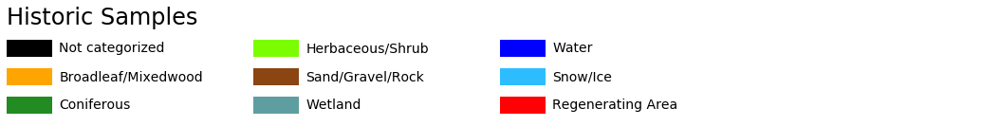

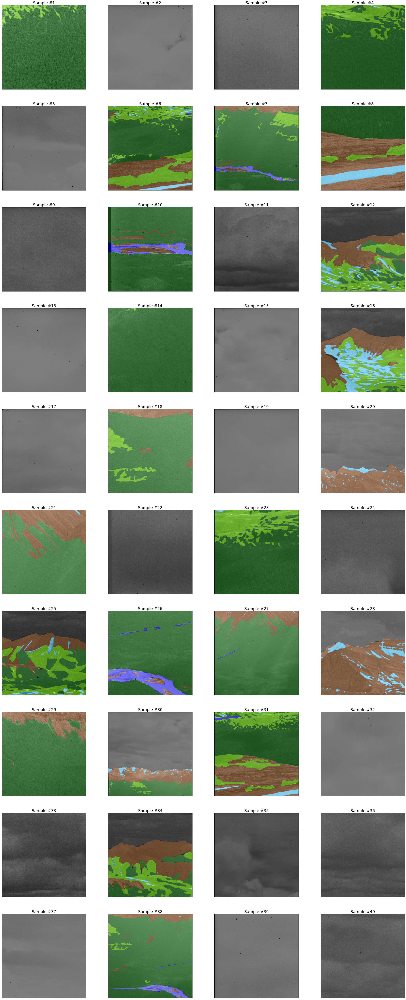

In [20]:
# ========================================
# View database samples with mask overlay
# - Grayscale, use default schema (LCC.A)
# ========================================

# Plot samples
plot_samples(
    imgs_gray, 
    colourize(masks_gray, dset_grayscale_meta.n_classes), 
    n_rows=10, 
    n_cols=4, 
    offset=0, 
    title='Historic Samples', 
    palette=dset_grayscale_meta.palette_hex
)

In [18]:
# ========================================
# Load augmented grayscale database
# ========================================
    
# Load dataset + metadata (uses generated database)
db_path_grayscale_aug = './data/db/_aug_db_pylc_grayscale_1605506381.h5'
dset_grayscale_aug = MLPDataset(db_path = db_path_grayscale_aug)
dset_grayscale_meta_aug = dset_grayscale_aug.get_meta()
imgs_gray_aug = dset_grayscale_aug.get_data('img').squeeze(1)
masks_gray_aug = dset_grayscale_aug.get_data('mask')
print_meta(dset_grayscale_meta_aug)



Profile Metadata
______________________________________________________________________
 ID                            _aug_db_pylc_grayscale_1605506381
 Channels                      1 (Grayscale)
 Classes                       9
 Samples                       181
 Tile size (WxH)               512px x 512px
 Pixel mean                    143.311
 Pixel std-dev                 25.805
 M2                            0.764
 JSD                           0.236

Palette (./schemas/schema_a.json)
______________________________________________________________________
 Code    Name                     RGB                 Hex            
______________________________________________________________________
 NC      Not categorized          R0   G0   B0        #000000        
 B-MW    Broadleaf/Mixedwood      R255 G165 B0        #ffa500        
 C       Coniferous               R34  G139 B34       #228b22        
 H-S     Herbaceous/Shrub         R124 G252 B0        #7cfc00        
 S-G-R   S

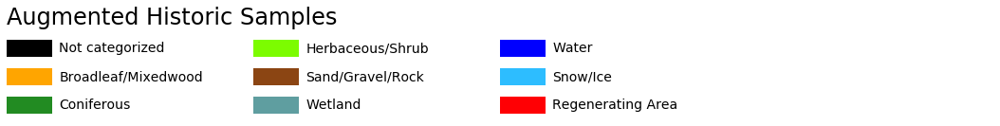

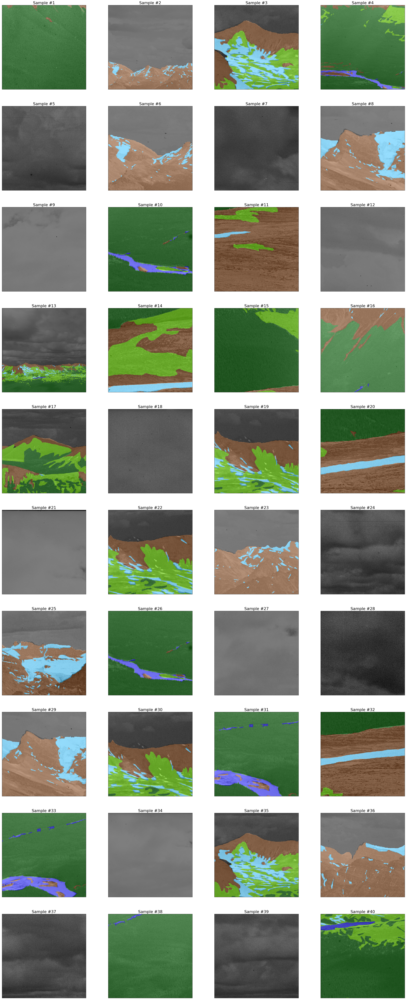

In [21]:
# ========================================
# View augmented database samples with mask overlay
# - Grayscale, use default schema (LCC.A)
# ========================================

# Plot samples
plot_samples(
    imgs_gray_aug, 
    colourize(masks_gray_aug, dset_grayscale_meta_aug.n_classes), 
    n_rows=10, 
    n_cols=4, 
    offset=0, 
    title='Augmented Historic Samples', 
    palette=dset_grayscale_meta_aug.palette_hex
)

In [10]:
# ========================================
# Load colour database
# ========================================
    
# Load dataset + metadata (uses generated database)
db_path_colour = './data/db/_db_pylc_colour_1605508764.h5'
dset_colour = MLPDataset(db_path = db_path_colour)
dset_colour_meta = dset_colour.get_meta()
imgs_colour = np.moveaxis(dset_colour.get_data('img'), 1, -1)
masks_colour = dset_colour.get_data('mask')
print_meta(dset_colour_meta)


Profile Metadata
______________________________________________________________________
 ID                            _db_pylc_colour_1605508764
 Channels                      3 (Colour)
 Classes                       9
 Samples                       134
 Tile size (WxH)               512px x 512px
 Pixel mean                    R142.398 G168.323 B191.337
 Pixel std-dev                 R19.549 G16.835 B13.242
 M2                            0.648
 JSD                           0.302

Palette (./schemas/schema_a.json)
______________________________________________________________________
 Code    Name                     RGB                 Hex            
______________________________________________________________________
 NC      Not categorized          R0   G0   B0        #000000        
 B-MW    Broadleaf/Mixedwood      R255 G165 B0        #ffa500        
 C       Coniferous               R34  G139 B34       #228b22        
 H-S     Herbaceous/Shrub         R124 G252 B0        

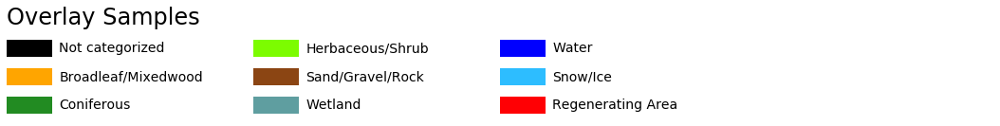

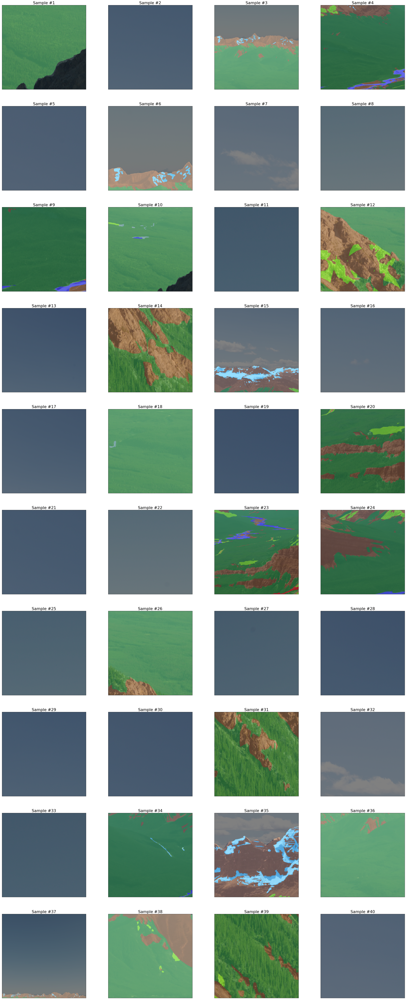

In [12]:
# ========================================
# View database samples with mask overlay
# - Colour, use default schema (LCC.A)
# ========================================

# Plot samples
plot_samples(
    imgs_colour, 
    colourize(masks_colour, dset_colour_meta.n_classes), 
    n_rows=10, 
    n_cols=4, 
    offset=0, 
    title='Overlay Samples', 
    palette=dset_colour_meta.palette_hex
)

In [23]:
# ========================================
# Load augmented colour database
# ========================================
    
# Load dataset + metadata (uses generated database)
db_path_colour_aug = './data/db/_aug_db_pylc_colour_1605508764.h5'
dset_colour_aug = MLPDataset(db_path = db_path_colour_aug)
dset_colour_meta_aug = dset_colour_aug.get_meta()
imgs_colour_aug = np.moveaxis(dset_colour_aug.get_data('img'), 1, -1)
masks_colour_aug = dset_colour_aug.get_data('mask')
print_meta(dset_colour_meta_aug)


Profile Metadata
______________________________________________________________________
 ID                            _aug_db_pylc_colour_1605508764
 Channels                      3 (Colour)
 Classes                       9
 Samples                       181
 Tile size (WxH)               512px x 512px
 Pixel mean                    R136.276 G159.436 B180.046
 Pixel std-dev                 R22.79 G19.917 B16.042
 M2                            0.731
 JSD                           0.267

Palette (./schemas/schema_a.json)
______________________________________________________________________
 Code    Name                     RGB                 Hex            
______________________________________________________________________
 NC      Not categorized          R0   G0   B0        #000000        
 B-MW    Broadleaf/Mixedwood      R255 G165 B0        #ffa500        
 C       Coniferous               R34  G139 B34       #228b22        
 H-S     Herbaceous/Shrub         R124 G252 B0     

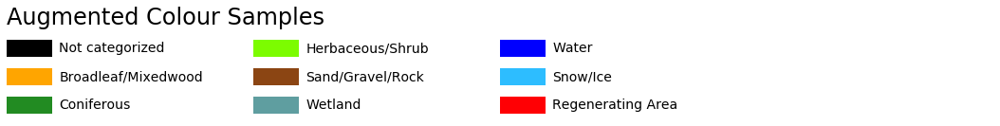

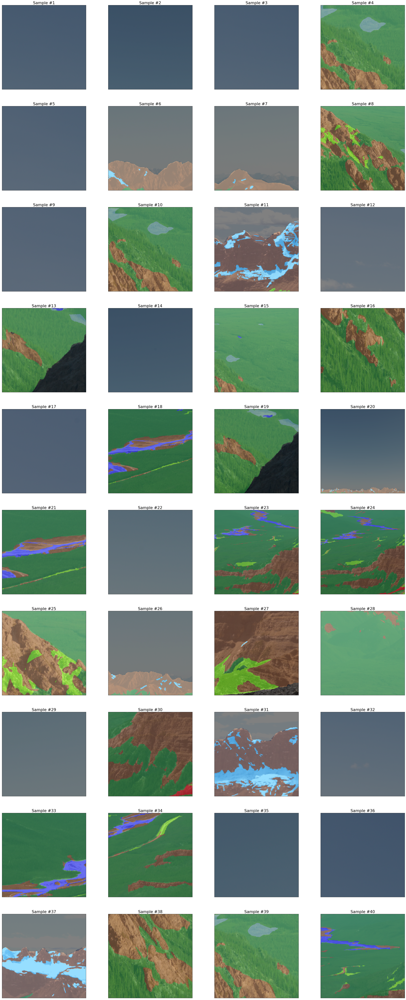

In [24]:
# ========================================
# View database samples with mask overlay
# - Grayscale, use default schema (LCC.A)
# ========================================

# Plot samples
plot_samples(
    imgs_colour_aug, 
    colourize(masks_colour_aug, dset_colour_meta.n_classes), 
    n_rows=10, 
    n_cols=4, 
    offset=0, 
    title='Augmented Colour Samples', 
    palette=dset_colour_meta_aug.palette_hex
)

Historic Captures: Extraction dataset profile

Class                          Prob         Weight

Not categorized            0.557482       0.045812
Broadleaf forest           0.003548       0.897199
Mixedwood forest           0.183211       0.112883
Coniferous forest          0.086039       0.207200
Shrub                      0.117024       0.162620
Herbaceous                 0.009323       0.722554
Rock                       0.001102       1.000000
Wetland                    0.023980       0.485193
Water                      0.018291       0.555745

Total samples: 8393
Sample Size: 512 x 512 = 262144 pixels

JSD: 0.213331


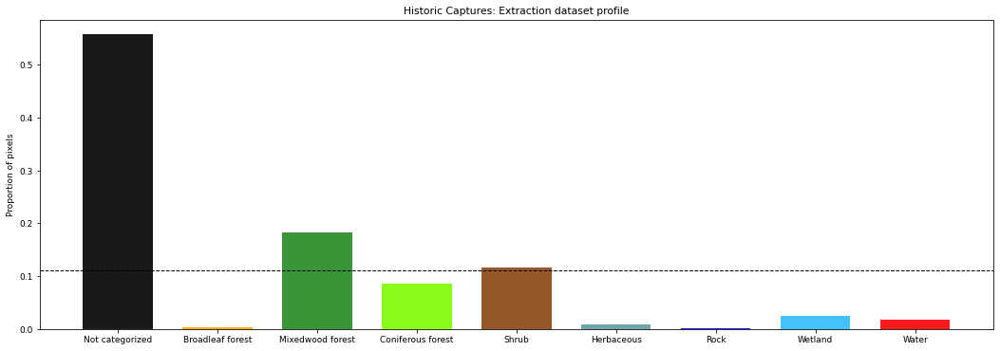

In [48]:
# =============================================
# Historic Captures: Class distribution profile
# =============================================
path = '/Users/boutrous/Workspace/MLP/mountain-legacy-project/data/metadata/historic/historic_extract.npy'
px_dist, px_count, dset_px_dist, dset_px_count, dset_probs, weights = load_data(path)
n_classes = 9

# category_labels_dst_a, category_abbr_labels_dst_a, palette_dst_a, map_categories_dst_a, hex_palette_dst_a,\
#     category_labels_dst_b, palette_dst_b, hex_palette_dst_b,\

# Plot overall pixel class profile
plot_profile(
    n_classes, 
    dset_probs, 
    len(px_dist), 
    category_labels_dst_a, 
    palette=hex_palette_dst_a,
    title='Historic Captures: Extraction dataset profile',
    save_path=os.path.join(root, 'data/metadata/historic/')
)

Augmentation Optimization Summary:
	Threshold: 0.9400000000000001
 	Rate Coefficient: 4.5
	Augmentation Samples: 3988
	Oversample Max: 4


Historic Captures: Augmented dataset profile

Class                          Prob         Weight

Not categorized            0.402146       0.066291
Broadleaf forest           0.011949       0.742327
Mixedwood forest           0.217984       0.109354
Coniferous forest          0.099715       0.206462
Shrub                      0.121644       0.176233
Herbaceous                 0.030309       0.475617
Rock                       0.003620       1.000000
Wetland                    0.055890       0.319152
Water                      0.056743       0.315731

Total samples: 12381
Sample Size: 512 x 512 = 262144 pixels

JSD: 0.129096


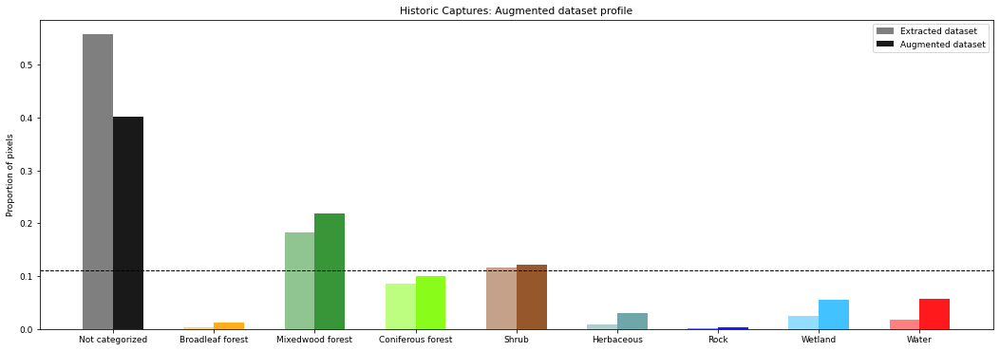

Data saved to: /Users/boutrous/Workspace/MLP/mountain-legacy-project/data/metadata/historic/test_profile.npy


In [53]:
# Parameter Grid Search: Data augmentation
def grid_search2(px_dist, px_count, dset_px_dist, dset_px_count, dset_probs, n_classes, rate_max):
    profile_data = []
    eps = 1e-8

    # Initialize oversample filter and class prior probabilities
    oversample_filter = np.clip(1/n_classes - dset_probs, a_min=0, a_max=1.)
    probs = px_dist/px_count
    probs_weighted = np.multiply(np.multiply(probs, 1/dset_probs), oversample_filter)

    # Calculate scores for oversampling
    scores = np.sqrt(np.sum(probs_weighted, axis=1))

    # Initialize augmentation parameters
    # rate coefficient ranges from 1 - 21
    rate_coefs = np.arange(1, 21, 0.5)
    # threshold between 
    thresholds = np.arange(0, 3., 0.01)
    aug_n_samples_max = 4000
    #delta_px = []
    jsd = []

    # initialize balanced model distribution
    balanced_px_prob = np.empty(n_classes)
    balanced_px_prob.fill(1/n_classes)

    # Grid search
    for i, rate_coef, in enumerate(rate_coefs):
        for j, threshold in enumerate(thresholds):
#             assert rate_coef >= 1, 'Rate coefficient must be >= one.'
            oversample = scores > threshold
            rates = np.multiply(oversample, rate_coef * scores).astype(int)
            # clip rates to max value 
            rates = np.clip(rates, 0, rate_max).astype(int)
            # limit to max number of augmented images
            if np.sum(rates) < aug_n_samples_max:
                aug_px_dist = np.multiply(np.expand_dims(rates, axis=1), px_dist)
                full_px_dist = px_dist + aug_px_dist
                full_px_probs = np.sum(full_px_dist, axis=0)/np.sum(full_px_dist)
                #delta_px += [np.sum(np.multiply(full_px_probs, oversample_filter))]
                jsd_sample = JSD(full_px_probs, balanced_px_prob)
                jsd += [jsd_sample]
                profile_data += [{
                    'probs': full_px_probs,
                    'scores': scores,
                    'threshold' : threshold,
                    'rate_coef': rate_coef,
                    'rates': rates,
                    'n_samples': int(np.sum(full_px_dist)/px_count),
                    'aug_n_samples': np.sum(rates),
                    'rate_max': rate_max,
                    'jsd':jsd_sample
                }]

    # Get parameters that minimize Jensen-Shannon Divergence metric
    if len(jsd) == 0:
        print('No augmentation optimization found')
        return
    optim_idx = np.argmin(np.asarray(jsd))
    return profile_data[optim_idx]



# ================================================
# Historic Augmentation: Parameter Grid Search
# ================================================

rate_max = 4
path = '/Users/boutrous/Workspace/MLP/mountain-legacy-project/data/metadata/historic/historic_extract.npy'
px_dist, px_count, dset_px_dist, dset_px_count, dset_probs, weights = load_data(path)

_profile_optim = grid_search2(
    px_dist, 
    px_count, 
    dset_px_dist, 
    dset_px_count, 
    dset_probs,
    n_classes,
    rate_max)

print('Augmentation Optimization Summary:') 
print('\tThreshold: {}\n \tRate Coefficient: {}\n\tAugmentation Samples: {}\n\tOversample Max: {}\n\n'.format(
    _profile_optim['threshold'], _profile_optim['rate_coef'], 
    _profile_optim['aug_n_samples'], _profile_optim['rate_max']))

plot_profile(
    n_classes, 
    _profile_optim['probs'], 
    _profile_optim['n_samples'], 
    category_labels_dst_a, 
    palette=hex_palette_dst_a,
    title='Historic Captures: Augmented dataset profile',
    overlay=dset_probs,
    label_1='Augmented dataset',
    label_2='Extracted dataset')

# save optimized parameters
optim_metadata = {
    'probs': _profile_optim['probs'],
    'n_samples': _profile_optim['aug_n_samples'],
    'weights': eval_weights(_profile_optim['probs']),
    'rates': _profile_optim['rates'],
    'threshold': _profile_optim['threshold'],
    'rate_coef': _profile_optim['rate_coef'],
    'oversample_max': _profile_optim['rate_max']
}
save_data('/Users/boutrous/Workspace/MLP/mountain-legacy-project/data/metadata/historic/test_profile.npy', optim_metadata)

Threshold: 1.29 \ Rate coefficient: 4.0


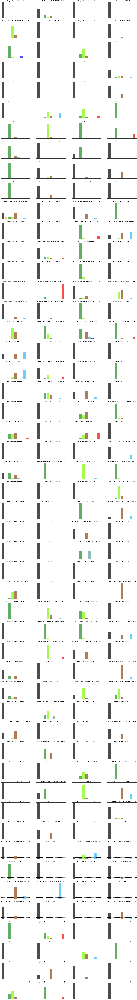

In [28]:
# ========================================
# show grid profile samples (optional)
# ========================================
plot_grid_profiles(
    px_dist/px_count, 
    _profile_optim, 
    n_rows=50, 
    n_cols=4, 
    offset=0
)

Training Dataset Summary:
	Total Samples: 6938

Historic Captures: Training dataset class profile

Class                          Prob         Weight

Not categorized            0.379777       0.074856
Broadleaf/Mixedwood forest       0.013886       0.755449
Coniferous forest          0.218458       0.117714
Herbaceous/Shrub           0.095230       0.230835
Sand/gravel/rock           0.122208       0.189340
Wetland                    0.036375       0.459042
Water                      0.005495       1.000000
Snow/Ice                   0.061986       0.319490
Regenerating Area          0.066586       0.303165

Total samples: 6938
Sample Size: 512 x 512 = 262144 pixels

JSD: 0.115334


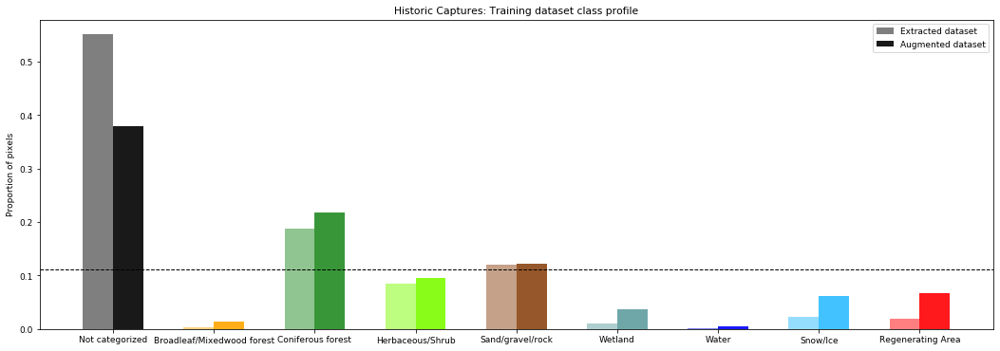

In [32]:
# ================================================
# Historic Captures: Augmentation - Update Profile
# ================================================

path_extract = paths['metadata']['combined']['historic']['extract']
px_dist_ext, px_count_ext, dset_px_dist_ext, dset_px_count_ext, dset_probs_ext, _ = load_data(path_extract)
path_augment = add_root(paths['metadata']['combined']['historic']['augment'])
px_dist_aug, px_count_aug, dset_px_dist_aug, dset_px_count_aug, dset_probs_aug, _ = load_data(path_augment)

# calculate pixel-class probabilities
dset_probs_extract = dset_px_dist_ext/dset_px_count_ext
dset_probs_aug = dset_px_dist_aug/dset_px_count_aug

print('Training Dataset Summary:') 
print('\tTotal Samples: {}\n'.format(n_samples))

plot_profile(
    n_classes,
    dset_probs_aug,
    n_samples, 
    category_labels_alt, 
    palette=hex_palette_alt, 
    title='Historic Captures: Training dataset class profile',
    overlay=dset_probs_extract,
    label_1='Augmented dataset',
    label_2='Extracted dataset')


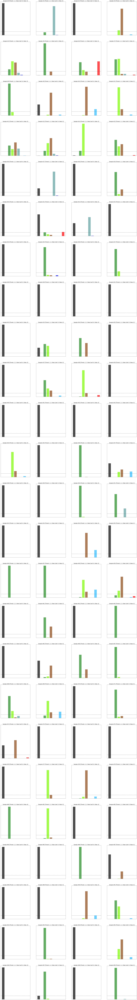

In [9]:
# ========================================
# show grid profile samples
# ========================================
plot_grid_profiles(px_dist_aug/px_count, _profile_optim, n_rows=25, n_cols=4, offset=0)

In [24]:
# ===============================================
# Script to embed Numpy metadata in Torch model file
# ===============================================

# model paths
model_path = '/Users/boutrous/Workspace/MLP/experiments/historic/deeplab/DLB-H-2.5/model.pth'
model = load_model (model_path)
new_model_path = './data/models/pylc_2-5_deeplab_ch1_schema_a.pth'

meta = defaults
# get metadata file data
# meta_path = './data/metadata/meta_ch3_schema_a.npy'
meta_path = './data/metadata/meta_ch1_schema_a.npy'
md = np.load(meta_path, allow_pickle=True).tolist()

# update model metadata
meta.ch = 1 if md.get('capture') == 'historic' else 3
meta.weights = md.get('weights')
meta.px_mean = md.get('px_mean')
meta.px_std = md.get('px_std')
meta.m2 = md.get('m2')
meta.jsd = md.get('jsd')
meta.dset_px_dist = md.get('dset_px_dist')
meta.dset_px_dist = md.get('probs')

torch.save({
    "model": model['model'],
    "meta": meta
}, new_model_path)

print('Saved updated model to: \n\t{}'.format(new_model_path))

Loaded model at path:
	/Users/boutrous/Workspace/MLP/experiments/historic/deeplab/DLB-H-2.5/model.pth
Saved updated model to: 
	./data/models/pylc_2-5_deeplab_ch1_schema_a.pth
